In [2]:
#http://dl.yf.io/lsun/scenes/
"""
bridge_train_lmdb.zip                              12-Mar-2017 23:01     15G
church_outdoor_train_lmdb.zip                      12-Mar-2017 23:03      2G
classroom_train_lmdb.zip                           12-Mar-2017 23:04      3G
conference_room_train_lmdb.zip                     12-Mar-2017 23:06      4G
dining_room_train_lmdb.zip                         12-Mar-2017 23:12     11G
restaurant_train_lmdb.zip                          12-Mar-2017 23:46     13G
tower_train_lmdb.zip                               12-Mar-2017 23:52     11G
"""
%mkdir data
!git clone https://github.com/fyu/lsun
%cd lsun
!python download.py -c conference_room -o ../data/ 
%cd ../data
!unzip conference_room_train_lmdb.zip && rm conference_room_train_lmdb.zip
%cd ..

Cloning into 'lsun'...
remote: Enumerating objects: 72, done.
remote: Total 72 (delta 0), reused 0 (delta 0), pack-reused 72
Unpacking objects: 100% (72/72), done.
/content/lsun
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 3860M  100 3860M    0     0  20.4M      0  0:03:08  0:03:08 --:--:-- 20.8M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 5191k  100 5191k    0     0  3313k      0  0:00:01  0:00:01 --:--:-- 3313k
/content/data
Archive:  conference_room_train_lmdb.zip
   creating: conference_room_train_lmdb/
  inflating: conference_room_train_lmdb/lock.mdb  
  inflating: conference_room_train_lmdb/data.mdb  
/content


In [0]:
import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

import matplotlib.pyplot as plt
import numpy as np
import random
import math

import os

In [5]:
data_PATH = "/content/data/"
log_PATH = os.path.join("/gdrive","My Drive","notebooks", "logs","wgan")
modelName = "WGAN_DCGAN_conference_lsun"

batch_size =64
workers = 2
epochs = 15

latent_size=100

gf_dim = 64
df_dim = 64

in_h = 64
in_w =64
c_dim = 3

n_critic = 5 # the number of iterations of the critic per generator iteration

lr = 0.00005

c = 0.01 # clip (-c,c)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

manualSeed = 3734
print("Random Seed: ",manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  3734


In [0]:
transform = transforms.Compose(
    [
     transforms.Resize((in_h,in_w)),
     transforms.ToTensor(),
     transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5)),
     ]
)
def transform_inverse (y):
  t= None
  if y.size()[0]==1:#1-dim
    t=torchvision.transforms.Normalize((-1,),(2,))
  else :#3-dim
    t=torchvision.transforms.Normalize((-1,-1,-1),(2,2,2))
  return t(y)

def batch_transform_inverse(y):
  x = y.new(*y.size())
  if y.size()[1]==1:
    x[:, 0, :, :] = y[:, 0, :, :] * 2 - 1
  else:
    x[:, 0, :, :] = y[:, 0, :, :] * 2 - 1
    x[:, 1, :, :] = y[:, 1, :, :] * 2 - 1 
    x[:, 2, :, :] = y[:, 2, :, :] * 2 - 1
  return x

In [7]:
lsun_dataset=torchvision.datasets.LSUN(root = data_PATH,
                                             classes= ['conference_room_train'],
                                 transform=transform)
train_loader = torch.utils.data.DataLoader(lsun_dataset,batch_size=batch_size,
                                          shuffle =True, num_workers=workers)
print(lsun_dataset)

Dataset LSUN
    Number of datapoints: 229069
    Root location: /content/data/
    Classes: ['conference_room_train']
    StandardTransform
Transform: Compose(
               Resize(size=(64, 64), interpolation=PIL.Image.BILINEAR)
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )


torch.Size([64, 3, 64, 64])


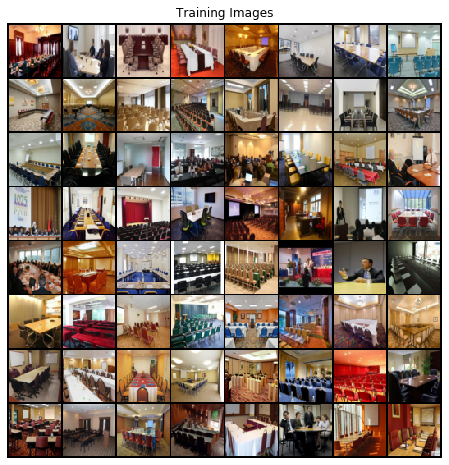

In [8]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device),padding=2, normalize=True).cpu(),(1,2,0)))

print(real_batch[0].size())

In [0]:
import torch.nn as nn

def conv_bn_layer(in_channels,out_channels,kernel_size,stride=1,padding=0):
    return nn.Sequential(
        nn.Conv2d(in_channels,out_channels,kernel_size,stride=stride,padding=padding,bias=False),
        nn.BatchNorm2d(out_channels,momentum=0.1,eps=1e-5),
    )
def tconv_bn_layer(in_channels,out_channels,kernel_size,stride=1,padding=0):
  return nn.Sequential(
      nn.ConvTranspose2d(in_channels,out_channels,kernel_size,stride=stride,padding=padding,bias=False),
      nn.BatchNorm2d(out_channels,momentum=0.1,eps=1e-5),
  )
def tconv_layer(in_channels,out_channels,kernel_size,stride=1,padding=0):
  return nn.ConvTranspose2d(in_channels,out_channels,kernel_size,stride=stride,padding=padding)

def conv_layer(in_channels,out_channels,kernel_size,stride=1,padding=0):
    return nn.Conv2d(in_channels,out_channels,kernel_size,stride=stride,padding=padding)

def fc_layer(in_features,out_features):
  return nn.Linear(in_features,out_features)

def fc_bn_layer(in_features,out_features):
  return nn.Sequential(
      nn.Linear(in_features,out_features,bias=False),
      nn.BatchNorm1d(out_features)
  )

In [0]:
def conv_out_size_same(size, stride):
  return int(math.ceil(float(size) / float(stride)))
s_h, s_w = in_h, in_w
s_h2, s_w2 = conv_out_size_same(s_h, 2), conv_out_size_same(s_w, 2)
s_h4, s_w4 = conv_out_size_same(s_h2, 2), conv_out_size_same(s_w2, 2)
s_h8, s_w8 = conv_out_size_same(s_h4, 2), conv_out_size_same(s_w4, 2)
s_h16, s_w16 = conv_out_size_same(s_h8, 2), conv_out_size_same(s_w8, 2)

In [0]:
import torch.nn as nn
import torch.nn.functional as F

class Generator(nn.Module):
  def __init__(self):
    super(Generator,self).__init__()
    self.fc_bn_layer1 = fc_bn_layer(latent_size,s_h16*s_w16*gf_dim*8)
    self.up_sample_layer2 = tconv_bn_layer(gf_dim*8,gf_dim*4,4,stride=2,padding=1)
    self.up_sample_layer3 = tconv_bn_layer(gf_dim*4,gf_dim*2,4,stride=2,padding=1)
    self.up_sample_layer4 = tconv_bn_layer(gf_dim*2,gf_dim,4,stride=2,padding=1)
    self.up_sample_layer5 = tconv_layer(gf_dim,c_dim,4,stride=2,padding=1)
    self.tanh = nn.Tanh()

  def forward(self, x):
    x = F.relu(self.fc_bn_layer1(x))
    x = x.view(-1,gf_dim*8,s_h16,s_w16)
    x = F.relu(self.up_sample_layer2(x))
    x = F.relu(self.up_sample_layer3(x))
    x = F.relu(self.up_sample_layer4(x))
    x = self.tanh(self.up_sample_layer5(x))
    return x

In [0]:
class Critic(nn.Module):
  def __init__(self):
    super(Critic,self).__init__()
    self.down_sample_layer1 = conv_layer(c_dim,df_dim,4,stride=2,padding=1)
    self.down_sample_layer2 = conv_bn_layer(df_dim,df_dim*2,4,stride=2,padding=1)
    self.down_sample_layer3 = conv_bn_layer(df_dim*2,df_dim*4,4,stride=2,padding=1)
    self.down_sample_layer4 = conv_bn_layer(df_dim*4,df_dim*8,4,stride=2,padding=1)
    self.fc_layer5 = fc_layer(df_dim*8*s_h16*s_w16,1)


  def forward(self, x):
    x = F.leaky_relu(self.down_sample_layer1(x),0.2)
    x = F.leaky_relu(self.down_sample_layer2(x),0.2)
    x = F.leaky_relu(self.down_sample_layer3(x),0.2)
    x = F.leaky_relu(self.down_sample_layer4(x),0.2)
    x = x.flatten(1)
    x = self.fc_layer5(x)
    return x

In [0]:
import torch.optim as optim

G = Generator().to(device)
fw = Critic().to(device)

G_optimizer = optim.RMSprop(G.parameters(),lr=lr)
fw_optimizer = optim.RMSprop(fw.parameters(),lr=lr)

fixed_noise = torch.randn(batch_size, latent_size,device=device)

In [19]:
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv')!=-1:
    nn.init.normal_(m.weight.data,0.0,0.02)
  elif classname.find('Norm')!=-1:
    nn.init.normal_(m.weight.data,1.0,0.02)

print(G.apply(weights_init))
print(fw.apply(weights_init))

Generator(
  (fc_bn_layer1): Sequential(
    (0): Linear(in_features=100, out_features=8192, bias=False)
    (1): BatchNorm1d(8192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (up_sample_layer2): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (up_sample_layer3): Sequential(
    (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (up_sample_layer4): Sequential(
    (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (up_sample_layer5): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (tanh): Tanh()
)
Critic(
 

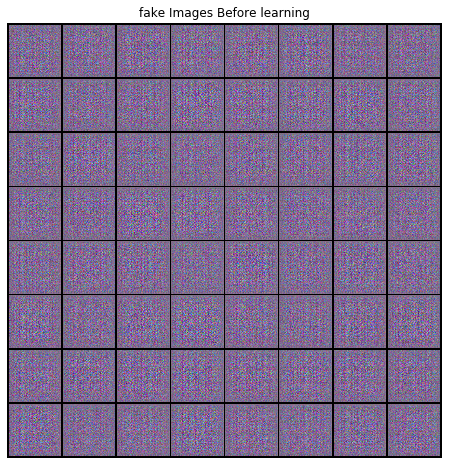

In [20]:
with torch.no_grad():
  fake_batch=G(fixed_noise)
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('fake Images Before learning')
plt.imshow(np.transpose(vutils.make_grid(fake_batch.to(device).view(64,c_dim,in_h,in_w),padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
img_list = []
G_losses = []
fw_losses = []

iter_per_plot = 500
plot_per_eps=(int(len(train_loader)/iter_per_plot))

transform_PIL=transforms.ToPILImage()

In [22]:
for ep in range(epochs):
  for i, (data, _) in enumerate(train_loader):
    b_size=data.shape[0]
    data = data.to(device)
    z = torch.randn(b_size,latent_size).to(device)
    fake = G(z)

    #Train critic function
    fw.zero_grad()
    real_critic = fwx = fw(data)
    fake_critic = fwg = fw(fake.detach())

    loss_fw = fwx.mean()-fwg.mean()
    loss_fw.backward()
    fw_optimizer.step()

    #weight clipping
    for p in fw.parameters():
      p.data.clamp_(-c, c)

    #Train G
    if (i+1)%n_critic==0:
      G.zero_grad()
      fwg = fw(fake)
      
      loss_G = fwg.mean()

      loss_G.backward()
      G_optimizer.step()

    if (i+1)%iter_per_plot == 0:
      print('Epoch [{}/{}], Step [{}/{}], critic_loss: {:.4f}, g_loss: {:.4f}, fw(x): {:.4f}, fw(G(z)): {:.4f}' 
            .format(ep, epochs, i+1, len(train_loader), loss_fw.item(),  fake_critic.mean().item(), 
                    real_critic.mean().item(), fake_critic.mean().item()))
      G_losses.append(fake_critic.mean().item())
      fw_losses.append(loss_fw.item())
      with torch.no_grad():
        G.eval()
        fake = G(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(torch.reshape(fake,(b_size,c_dim,in_h,in_w))[:64], padding=2, normalize=True))
        transform_PIL(img_list[-1]).save(os.path.join(log_PATH,str(ep)+modelName+"_Last.png"))
        G.train()

Epoch [0/15], Step [500/3580], critic_loss: -1.2213, g_loss: 0.6071, fw(x): -0.6142, fw(G(z)): 0.6071
Epoch [0/15], Step [1000/3580], critic_loss: -1.3295, g_loss: 0.6739, fw(x): -0.6556, fw(G(z)): 0.6739
Epoch [0/15], Step [1500/3580], critic_loss: -1.3837, g_loss: 0.6931, fw(x): -0.6906, fw(G(z)): 0.6931
Epoch [0/15], Step [2000/3580], critic_loss: -1.4021, g_loss: 0.7089, fw(x): -0.6932, fw(G(z)): 0.7089
Epoch [0/15], Step [2500/3580], critic_loss: -1.4147, g_loss: 0.7044, fw(x): -0.7103, fw(G(z)): 0.7044
Epoch [0/15], Step [3000/3580], critic_loss: -1.3943, g_loss: 0.6968, fw(x): -0.6975, fw(G(z)): 0.6968
Epoch [0/15], Step [3500/3580], critic_loss: -1.2165, g_loss: 0.6456, fw(x): -0.5709, fw(G(z)): 0.6456
Epoch [1/15], Step [500/3580], critic_loss: -1.3028, g_loss: 0.6543, fw(x): -0.6486, fw(G(z)): 0.6543
Epoch [1/15], Step [1000/3580], critic_loss: -0.9909, g_loss: 0.2909, fw(x): -0.7000, fw(G(z)): 0.2909
Epoch [1/15], Step [1500/3580], critic_loss: -1.2377, g_loss: 0.6490, fw(x)

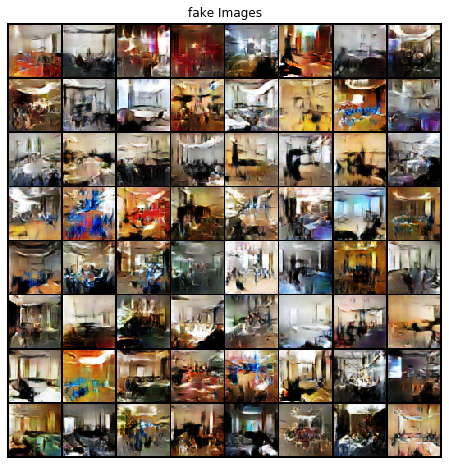

In [26]:
with torch.no_grad():
  G.eval()
  fake_batch=G(fixed_noise)
  G.train()
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('fake Images')
plt.imshow(np.transpose(vutils.make_grid(fake_batch.to(device)[:64].view(64,c_dim,in_h,in_w),padding=2, normalize=True).cpu(),(1,2,0)))

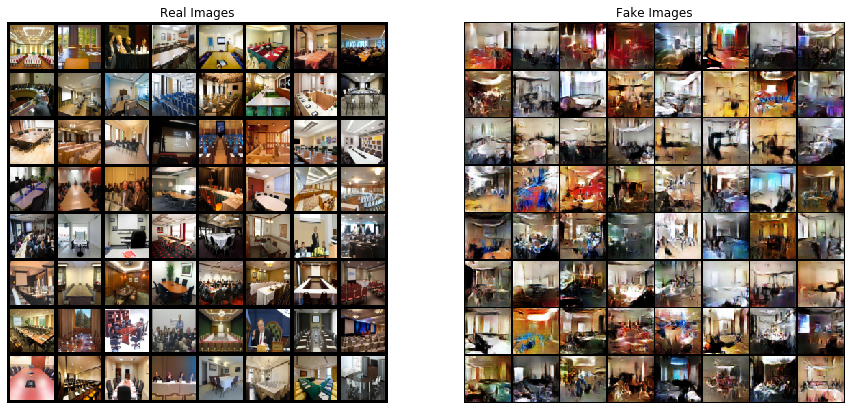

In [28]:
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))

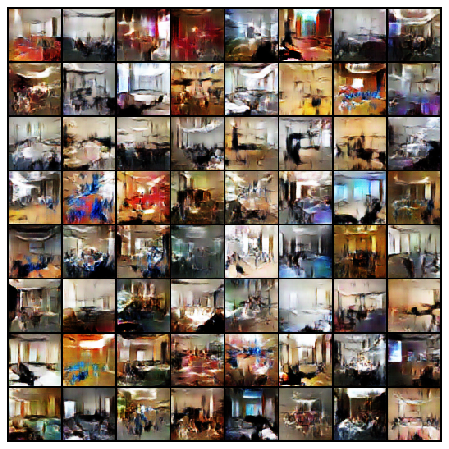

In [35]:
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [0]:
from PIL import Image
transform_PIL=transforms.ToPILImage()

p_img_list = [transform_PIL(p_image) for p_image in img_list]
p_img_list[0].save(os.path.join(log_PATH,modelName+'.gif'), save_all=True,append_images=p_img_list[1:], optimize=False, duration=0.5, loop=0)
p_img_list[-1].save(os.path.join(log_PATH,modelName+"_last_result.png"))

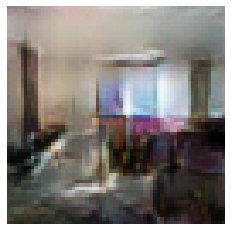

In [43]:
with torch.no_grad():
  G.eval()
  random_noise=torch.randn(batch_size,latent_size,device=device)
  fake=G(random_noise)
  G.train()
fake = fake.squeeze().cpu()
fake_image=transform_inverse(fake[0])
plt.axis("off")
plt.imshow(np.transpose(fake_image,(1,2,0)))

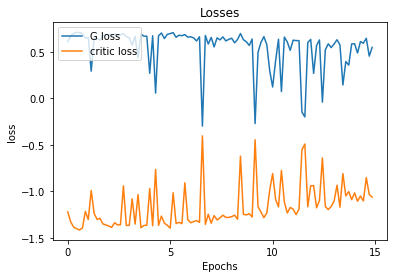

In [47]:
plt.title("Losses")
epsilon = 1/plot_per_eps
X = np.array(range(plot_per_eps*epochs))/plot_per_eps

plt.plot(X,G_losses,label="G loss")
plt.plot(X,fw_losses,label="critic loss")
plt.legend(loc=2)
plt.xticks(np.arange(0,epochs+1,5)) 
plt.ylabel("loss")
plt.xlabel("Epochs")
#plt.show()
plt.savefig(os.path.join(modelName+"_loss_figure.png"))

In [51]:
torch.save(G.state_dict(),os.path.join(log_PATH,"./G_"+modelName+".pth"))
G.load_state_dict(torch.load(os.path.join(log_PATH,("G_"+modelName+".pth"))))

<All keys matched successfully>

In [52]:
torch.save(fw.state_dict(),os.path.join(log_PATH,"./critic_"+modelName+".pth"))
fw.load_state_dict(torch.load(os.path.join(log_PATH,("critic_"+modelName+".pth"))))

<All keys matched successfully>